# toup API를 이용한 2019년 전국 행사/축제 데이터 시각화

In [10]:
import urllib.request
from bs4 import BeautifulSoup as bs
import pandas as pd
import requests
import math
import numpy as np

## tour API 를 이용한 크롤링

In [132]:
URL = "http://api.visitkorea.or.kr/openapi/service/rest/KorService/searchFestival?ServiceKey=%2FBKtZx5AE8N9QIwlAT34kWZ%2BUmds7UxWh5D5bmT%2FFv%2FVXE0nQ1001VNm%2BO0NL3iQO%2BVrWuqReJMZmZKvRfWYjQ%3D%3D&MobileOS=ETC&MobileApp=TourAPI3.0_Guide&arrange=A"
# service key는 홈페이지에서 로그인 후 발급 가능 

eventStartDate = "&eventStartDate=" +"20190101"
eventEndDate = "&eventEndDate=" +"20191231"

totalCountURL = "http://api.visitkorea.or.kr/openapi/service/rest/KorService/searchFestival?ServiceKey=%2FBKtZx5AE8N9QIwlAT34kWZ%2BUmds7UxWh5D5bmT%2FFv%2FVXE0nQ1001VNm%2BO0NL3iQO%2BVrWuqReJMZmZKvRfWYjQ%3D%3D&MobileOS=ETC&MobileApp=TourAPI3.0_Guide&arrange=A&numOfRows=12&pageNo=1"+eventStartDate+eventEndDate
res = requests.get(totalCountURL)
soup= bs(res.text, 'html.parser')
totalCount = int(soup.find("totalcount").text)


pageNo = math.ceil(totalCount/12)

df_2019 = pd.DataFrame()

print(totalCount)
print(pageNo)

for i in range(1, int(pageNo +2)):
    pageURL = "http://api.visitkorea.or.kr/openapi/service/rest/KorService/searchFestival?ServiceKey=%2FBKtZx5AE8N9QIwlAT34kWZ%2BUmds7UxWh5D5bmT%2FFv%2FVXE0nQ1001VNm%2BO0NL3iQO%2BVrWuqReJMZmZKvRfWYjQ%3D%3D&MobileOS=ETC&MobileApp=TourAPI3.0_Guide&arrange=A&numOfRows=12"+"&pageNo="+str(i)+eventStartDate+eventEndDate
    res = requests.get(pageURL)
    soup= bs(res.text, 'html.parser')
    count = len(soup.find_all("title"))
    
    for j in range(0, count):
        title = soup.find_all("title")[j].text
        if soup.find_all("item")[j].find_all("addr1") == []:
            address = 0
        else : 
            address = soup.find_all("item")[j].find("addr1").text 
        
        startDate = soup.find_all("eventstartdate")[j].text
        endDate = soup.find_all("eventenddate")[j].text
        
        if soup.find_all("item")[j].find_all("areacode") == []:
            areacode = 0
        else : 
            areacode = soup.find_all("item")[j].find("areacode").text 
            
        if soup.find_all("item")[j].find_all("sigungucode") == []:
            sigungucode = 0
        else : 
            sigungucode = soup.find_all("item")[j].find("sigungucode").text
        
        
        if soup.find_all("item")[j].find_all("readcount") == []:
            readcount = 0
        else : 
            readcount = soup.find_all("item")[j].find("readcount").text 
            
            
        if soup.find_all("item")[j].find_all("mapx") ==[]:
            mapx = 0
        else:
            mapx = soup.find_all("item")[j].find("mapx").text
            
            
        if soup.find_all("item")[j].find_all("mapy") ==[]:
            mapy = 0
        else:
            mapy = soup.find_all("item")[j].find("mapy").text
        
        df_2019 = df_2019.append({"title": title, "address": address, "startDate": startDate,"endDate": endDate,"areacode":areacode,"readcount":readcount, "sigungucode": sigungucode,"mapx":mapx,"mapy":mapy}, ignore_index=True)
df_2019    

1489
125


,address,areacode,endDate,mapx,mapy,readcount,sigungucode,startDate,title
0,서울특별시 송파구 양재대로 932,1,20191012,127.1109831778,37.4960925880,8205,18,20191011,가락몰 페스티벌 2019
1,강원도 정선군 북평면 중봉길 41-35,32,20190817,128.6097538017,37.4742535268,0,11,20190816,가리왕산 뮤직 페스티벌 2019
2,전라북도 전주시 덕진구 기린대로 451,37,20190810,127.1271379505,35.8407442535,35598,12,20190808,가맥축제 2019
3,경상남도 밀양시 중앙로 324 영남루 및 밀양강 야외 공연장 일대,36,20191019,128.7552590901,35.4921350361,2050,7,20191018,"가을 밀양강 오딧세이 ""아리랑 환타지! 밀양!"" 2019"
4,경기도 광주시 도척면 도척윗로 278,31,20191110,127.2922239974,37.3374836915,0,5,20191012,가을 화담숲 단풍 축제 2019
...,...,...,...,...,...,...,...,...,...
1484,경상북도 청송군 청송읍 금월로 269,35,20191103,129.0555199169,36.4331924602,69397,21,20191030,[문화관광축제] 청송사과축제 2019
1485,광주광역시 동구 서남로 1,5,20191006,126.9231294053,35.1454973445,107608,3,20191003,[문화관광축제] 추억의 충장축제 2019
1486,경상남도 통영시 통영해안로 328,36,20190814,128.4241721001,34.8438295639,100521,17,20190810,[문화관광축제] 통영한산대첩축제 2019
1487,강원도 평창군 봉평면 이효석길 157,32,20190915,128.3753929122,37.6146411618,207766,15,20190907,[문화관광축제] 평창효석문화제 2019


In [142]:
df_2019.to_csv("df_2019.csv", index=False)

In [143]:
df_2019.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1489 entries, 0 to 1488
Data columns (total 9 columns):
address        1489 non-null object
areacode       1489 non-null object
endDate        1489 non-null object
mapx           1489 non-null object
mapy           1489 non-null object
readcount      1489 non-null object
sigungucode    1489 non-null object
startDate      1489 non-null object
title          1489 non-null object
dtypes: object(9)
memory usage: 104.8+ KB


## 데이터 타입 변환

In [144]:
df_2019["mapx"] =pd.to_numeric(df_2019["mapx"])
df_2019["mapy"] =pd.to_numeric(df_2019["mapy"])
df_2019["areacode"] =pd.to_numeric(df_2019["areacode"])
df_2019["sigungucode"] =pd.to_numeric(df_2019["sigungucode"])
df_2019["readcount"] =pd.to_numeric(df_2019["readcount"])
df_2019["readcount"] =pd.to_numeric(df_2019["readcount"])


## 결측치 제거

In [145]:
df_2019.drop(df_2019[df_2019["mapx"]==0 ].index,inplace=True)
df_2019.drop(df_2019[df_2019["areacode"]==0].index,inplace=True)
df_2019.drop(df_2019[df_2019["address"]==0].index,inplace=True)

## "month"칼럼 생성

In [146]:
df_2019["month"] = df_2019["startDate"].apply(lambda x : x[4:6])

## areacode dataframe 생성

In [147]:
areacode = pd.DataFrame()
areacode["areacode"] = [ 1,2,3,4,5,6,7,8,31,32,33,34,35,36,37,38,39]
areacode["지역"] =["서울","인천","대전","대구","광주","부산","울산","세종특별자치시","경기도","강원도","충청북도","충청남도","경상북도"
                ,"경상남도","전라북도","전라남도","제주도"]
areacode

,areacode,지역
0,1,서울
1,2,인천
2,3,대전
3,4,대구
4,5,광주
5,6,부산
6,7,울산
7,8,세종특별자치시
8,31,경기도
9,32,강원도


## "지역" 칼럼 추가

In [148]:
df_2019 = pd.merge(df_2019,areacode,how="left",on="areacode")

## "시구군" 칼럼 추가

In [149]:
df_2019["시구군"] = df_2019["address"].apply(lambda x : x.split(" ")[1])

## 임시 DataFrame

In [150]:
df_2019.head()

,address,areacode,endDate,mapx,mapy,readcount,sigungucode,startDate,title,month,지역,시구군
0,서울특별시 송파구 양재대로 932,1,20191012,127.110983,37.496093,8205,18,20191011,가락몰 페스티벌 2019,10,서울,송파구
1,강원도 정선군 북평면 중봉길 41-35,32,20190817,128.609754,37.474254,0,11,20190816,가리왕산 뮤직 페스티벌 2019,08,강원도,정선군
2,전라북도 전주시 덕진구 기린대로 451,37,20190810,127.127138,35.840744,35598,12,20190808,가맥축제 2019,08,전라북도,전주시
3,경상남도 밀양시 중앙로 324 영남루 및 밀양강 야외 공연장 일대,36,20191019,128.755259,35.492135,2050,7,20191018,"가을 밀양강 오딧세이 ""아리랑 환타지! 밀양!"" 2019",10,경상남도,밀양시
4,경기도 광주시 도척면 도척윗로 278,31,20191110,127.292224,37.337484,0,5,20191012,가을 화담숲 단풍 축제 2019,10,경기도,광주시


In [ ]:
df_2019.to_csv("df_2019.csv", index=False)

In [ ]:
df_2019_final = pd.read_csv("df_2019.csv")

geo_data에 있는 지역명은 영어, 한글과 매칭시켜야 한다

In [48]:
df1 = pd.DataFrame({"지역": df_2019_final["지역"].unique(), "name_eng" :['Seoul','Gangwon-do',  'Jeollabuk-do', 'Gyeongsangnam-do','Gyeonggi-do','Busan', 'Daegu','Jeju-do',
           'Gyeongsangbuk-do' ,'Gwangju','Jeollanam-do' ,  'Incheon','Chungcheongbuk-do',
           'Daejeon', 'Chungcheongnam-do','Ulsan','Sejongsi' ]})
df1

,지역,name_eng
0,서울,Seoul
1,강원도,Gangwon-do
2,전라북도,Jeollabuk-do
3,경상남도,Gyeongsangnam-do
4,경기도,Gyeonggi-do
5,부산,Busan
6,대구,Daegu
7,제주도,Jeju-do
8,경상북도,Gyeongsangbuk-do
9,광주,Gwangju


## "name_eng" 칼럼 추가

In [50]:
df_2019_final = pd.merge(df_2019_final, df1, how = "left")
df_2019_final

,address,areacode,endDate,mapx,mapy,readcount,sigungucode,startDate,title,month,지역,시구군,name_eng
0,서울특별시 송파구 양재대로 932,1,20191012,127.110983,37.496093,8205,18,20191011,가락몰 페스티벌 2019,10,서울,송파구,Seoul
1,강원도 정선군 북평면 중봉길 41-35,32,20190817,128.609754,37.474254,0,11,20190816,가리왕산 뮤직 페스티벌 2019,8,강원도,정선군,Gangwon-do
2,전라북도 전주시 덕진구 기린대로 451,37,20190810,127.127138,35.840744,35598,12,20190808,가맥축제 2019,8,전라북도,전주시,Jeollabuk-do
3,경상남도 밀양시 중앙로 324 영남루 및 밀양강 야외 공연장 일대,36,20191019,128.755259,35.492135,2050,7,20191018,"가을 밀양강 오딧세이 ""아리랑 환타지! 밀양!"" 2019",10,경상남도,밀양시,Gyeongsangnam-do
4,경기도 광주시 도척면 도척윗로 278,31,20191110,127.292224,37.337484,0,5,20191012,가을 화담숲 단풍 축제 2019,10,경기도,광주시,Gyeonggi-do
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1480,경상북도 청송군 청송읍 금월로 269,35,20191103,129.055520,36.433192,69397,21,20191030,[문화관광축제] 청송사과축제 2019,10,경상북도,청송군,Gyeongsangbuk-do
1481,광주광역시 동구 서남로 1,5,20191006,126.923129,35.145497,107608,3,20191003,[문화관광축제] 추억의 충장축제 2019,10,광주,동구,Gwangju
1482,경상남도 통영시 통영해안로 328,36,20190814,128.424172,34.843830,100521,17,20190810,[문화관광축제] 통영한산대첩축제 2019,8,경상남도,통영시,Gyeongsangnam-do
1483,강원도 평창군 봉평면 이효석길 157,32,20190915,128.375393,37.614641,207766,15,20190907,[문화관광축제] 평창효석문화제 2019,9,강원도,평창군,Gangwon-do


In [52]:
df_2019_final.to_csv("df_2019_final.csv", index=False)

## 완성된 DataFrame

In [12]:
df_2019_final = pd.read_csv("df_2019_final.csv")
df_2019_final.head()

,address,areacode,endDate,mapx,mapy,readcount,sigungucode,startDate,title,month,지역,시구군,name_eng
0,서울특별시 송파구 양재대로 932,1,20191012,127.110983,37.496093,8205,18,20191011,가락몰 페스티벌 2019,10,서울,송파구,Seoul
1,강원도 정선군 북평면 중봉길 41-35,32,20190817,128.609754,37.474254,0,11,20190816,가리왕산 뮤직 페스티벌 2019,8,강원도,정선군,Gangwon-do
2,전라북도 전주시 덕진구 기린대로 451,37,20190810,127.127138,35.840744,35598,12,20190808,가맥축제 2019,8,전라북도,전주시,Jeollabuk-do
3,경상남도 밀양시 중앙로 324 영남루 및 밀양강 야외 공연장 일대,36,20191019,128.755259,35.492135,2050,7,20191018,"가을 밀양강 오딧세이 ""아리랑 환타지! 밀양!"" 2019",10,경상남도,밀양시,Gyeongsangnam-do
4,경기도 광주시 도척면 도척윗로 278,31,20191110,127.292224,37.337484,0,5,20191012,가을 화담숲 단풍 축제 2019,10,경기도,광주시,Gyeonggi-do


#  matplot을 이용한 barplot 시각화

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt

### matplot에 한글 패치

In [17]:
import matplotlib as mpl
import os
from matplotlib import font_manager as fm, rcParams

fm.get_fontconfig_fonts()
font_location = 'C:/Windows/Fonts/NanumGothic.ttf' # For Windows, NanumGothic.ttf 설치 필요(네이버 무료 폰트)
font_name = fm.FontProperties(fname=font_location).get_name()
mpl.rc('font', family=font_name)


In [13]:
df_2019_final["readcount"] = df_2019_final["readcount"].apply(lambda x : None if x==0 else x)
readcount_mean =[]
for i in range(len(df_2019_final["month"].unique())):
    
    a = df_2019_final.loc[df_2019_final["month"]==df_2019_final["month"].unique()[i],'readcount'].mean(skipna=True)
    readcount_mean.append(round(a))
    
readcount_mean

[36036,
 29235,
 31622,
 28720,
 32351,
 39538,
 44457,
 44944,
 22996,
 19827,
 44488,
 7623]

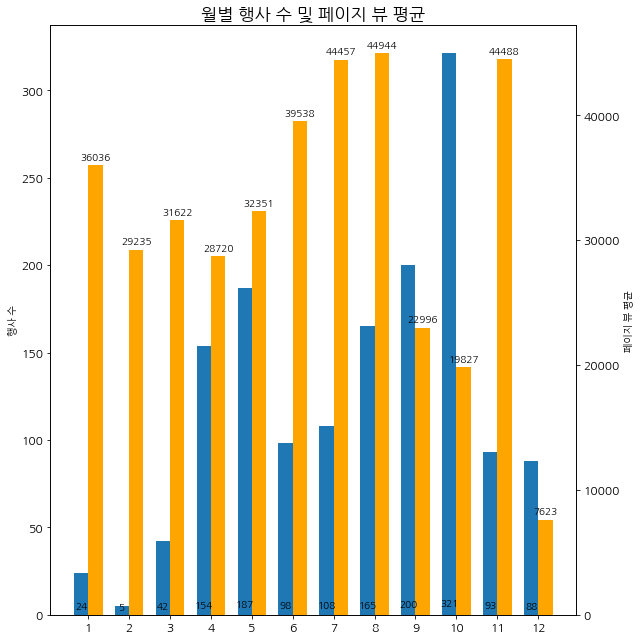

In [23]:

labels = [1,2,3,4,5,6,7,8,9,10,11,12]
counts = df_2019_final["month"].value_counts().reindex([1,2,3,4,5,6,7,8,9,10,11,12])
readcount_mean = readcount_mean

x = np.arange(len(labels))  # the label locations
width = 0.35  # the width of the bars

fig, ax1 = plt.subplots(1,1,figsize=(9,9))


rects1 = ax1.bar(x - width/2, counts, width, label='event counts')
ax2 = ax1.twinx()
rects2 = ax2.bar(x + width/2, readcount_mean, width, label='page view average',color="orange")

# Add some text for labels, title and custom x-axis tick labels, etc.
ax1.set_ylabel('행사 수')
ax2.set_ylabel('페이지 뷰 평균')
ax1.set_title('월별 행사 수 및 페이지 뷰 평균', fontsize = "xx-large")
ax1.set_xticks(x)
ax1.set_xticklabels(labels)



def autolabel(rects):
    """Attach a text label above each bar in *rects*, displaying its height."""
    for rect in rects:
        height = rect.get_height()
        ax2.annotate('{}'.format(height),
                    xy=(rect.get_x() + rect.get_width() / 2, height),
                    xytext=(0, 3),  # 3 points vertical offset
                    textcoords="offset points",
                    ha='center', va='bottom')
        


autolabel(rects1)
autolabel(rects2)

fig.tight_layout()

plt.show()

봄(3,4월)과 가을(9, 10월)에 행사 수가 많다.  
여름(6, 7월)의 행사에 대한 페이지 뷰의 평균이 높은걸로 보아 여름에 하는 행사에 대한 관심이 많다는 것을 알 수 있다. 

In [132]:
months = {'month1' : [],'month2' : [], 'month3' : [],'month4' : [],'month5' : [],'month6' : [],'month7' : [],
          'month8' : [],'month9' : [], 'month10' : [], 'month11' : [],'month12' : []}

for n in range(1, 13):
    a = 'month'+str(n)
    for i in range(len(df_2019_final["지역"].unique())):
        b = len(df_2019_final[((df_2019_final["month"]==n) & (df_2019_final["지역"] == df_2019_final["지역"].unique()[i]))])
        months[a].append(b)
    print(months[a])

        
months['month12']


[16, 1, 0, 0, 3, 1, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0]
[2, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[12, 3, 1, 6, 8, 2, 0, 2, 2, 0, 3, 0, 0, 1, 2, 0, 0]
[30, 11, 8, 15, 22, 13, 5, 4, 6, 2, 9, 2, 6, 2, 17, 2, 0]
[46, 29, 14, 7, 28, 13, 11, 8, 4, 3, 10, 1, 4, 2, 3, 4, 0]
[21, 9, 3, 5, 23, 7, 6, 5, 5, 1, 2, 1, 1, 1, 4, 3, 1]
[15, 21, 4, 11, 15, 2, 3, 6, 10, 5, 2, 4, 1, 2, 6, 1, 0]
[30, 28, 9, 7, 18, 6, 7, 9, 8, 4, 6, 5, 9, 4, 10, 3, 2]
[49, 14, 4, 12, 31, 11, 8, 5, 16, 2, 11, 7, 10, 7, 8, 4, 1]
[83, 31, 22, 21, 21, 23, 9, 11, 17, 8, 26, 2, 15, 8, 13, 9, 2]
[21, 5, 1, 13, 12, 11, 5, 6, 7, 1, 2, 2, 0, 3, 4, 0, 0]
[19, 7, 1, 4, 21, 3, 4, 5, 4, 0, 3, 7, 2, 1, 5, 2, 0]


[19, 7, 1, 4, 21, 3, 4, 5, 4, 0, 3, 7, 2, 1, 5, 2, 0]

In [159]:
df3 = pd.DataFrame(months, index=df_2019_final["지역"].unique())
df3.reset_index(inplace =True)


In [160]:
df3

,index,month1,month2,month3,month4,month5,month6,month7,month8,month9,month10,month11,month12
0,서울,16,2,12,30,46,21,15,30,49,83,21,19
1,강원도,1,1,3,11,29,9,21,28,14,31,5,7
2,전라북도,0,1,1,8,14,3,4,9,4,22,1,1
3,경상남도,0,0,6,15,7,5,11,7,12,21,13,4
4,경기도,3,1,8,22,28,23,15,18,31,21,12,21
5,부산,1,0,2,13,13,7,2,6,11,23,11,3
6,대구,0,0,0,5,11,6,3,7,8,9,5,4
7,제주도,0,0,2,4,8,5,6,9,5,11,6,5
8,경상북도,2,0,2,6,4,5,10,8,16,17,7,4
9,광주,0,0,0,2,3,1,5,4,2,8,1,0


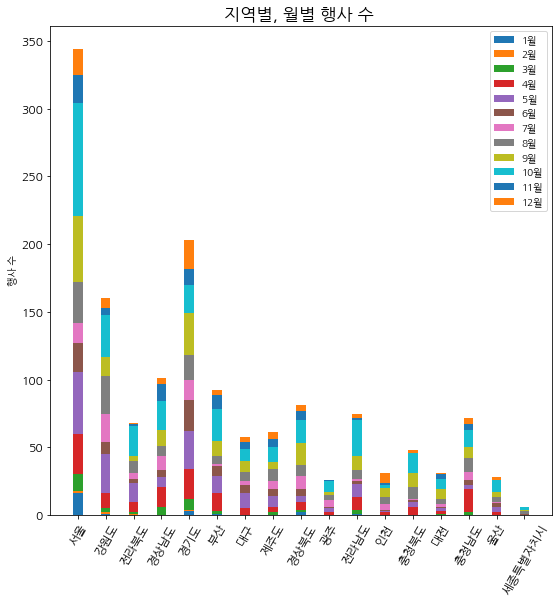

In [181]:
N = 17

provinces = df_2019_final["지역"].unique()

ind = np.arange(N)    # the x locations for the groups
width = 0.35       # the width of the bars: can also be len(x) sequence

plt.figure(figsize=(9, 9))
p1 = plt.bar(ind, months['month1'], width)
p2 = plt.bar(ind, months['month2'], width, bottom =df3['month1'])
p3 = plt.bar(ind, months['month3'], width, bottom =df3['month1']+df3['month2'])
p4 = plt.bar(ind, months['month4'], width, bottom =df3['month1']+df3['month2']+df3['month3'])
p5 = plt.bar(ind, months['month5'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4'])
p6 = plt.bar(ind, months['month6'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5'])
p7 = plt.bar(ind, months['month7'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6'])
p8 = plt.bar(ind, months['month8'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6']+df3['month7'])
p9 = plt.bar(ind, months['month9'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6']+df3['month7']+df3['month8'])
p10 = plt.bar(ind, months['month10'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6']+df3['month7']+df3['month8']+df3['month9'])
p11= plt.bar(ind, months['month11'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6']+df3['month7']+df3['month8']+df3['month9']+df3['month10'])
p12 = plt.bar(ind, months['month12'], width, bottom =df3['month1']+df3['month2']+df3['month3']+df3['month4']+df3['month5']+df3['month6']+df3['month7']+df3['month8']+df3['month9']+df3['month10']+df3['month11'])

plt.ylabel('행사 수')
plt.title('지역별, 월별 행사 수 ', fontsize = "xx-large")
plt.xticks(ind,provinces,rotation=60)
plt.legend((p1[0], p2[0],p3[0],p4[0], p5[0],p6[0],p7[0], p8[0],p9[0],p10[0], p11[0],p12[0]),
           ('1월', '2월','3월','4월', '5월','6월','7월', '8월','9월','10월', '11월','12월'))



plt.show()

서울, 경기도, 강원도 순으로 행사 수가 많다.  
각 지역별 바의 색 분포를 보았을 때, 분포가 비슷한 것을 보아 지역에 따른 월별 행사 분포는 대체로 비슷한 것을 알 수 있다. 

# folium을 이용한 지도 시각화

In [4]:
import folium
import json

## 도시별 인구수, 중심 좌표 table

In [27]:
provinces = df_2019_final['지역'].unique()

In [28]:
name_eng =['Seoul','Gangwon-do',  'Jeollabuk-do', 'Gyeongsangnam-do','Gyeonggi-do','Busan', 'Daegu','Jeju-do',
           'Gyeongsangbuk-do' ,'Gwangju','Jeollanam-do' ,  'Incheon','Chungcheongbuk-do',
           'Daejeon', 'Chungcheongnam-do','Ulsan','Sejongsi' ]

In [29]:
df1 =pd.DataFrame([{"centery":37.56,"centerx": 127}, {"centery":37.55 ,"centerx":128.21 },
                  {"centery":35.71,"centerx": 127.14}, {"centery":35.25,"centerx":128.66 },
                  {"centery":37.56,"centerx": 127.19}, {"centery":35.19,"centerx":129.05 },
                  {"centery":35.79,"centerx": 128.58}, {"centery":33.36,"centerx":126.54},
                  {"centery":36.24,"centerx": 128.66}, {"centery":35.12,"centerx":126.83},
                  {"centery":34.81,"centerx": 126.89}, {"centery":37.46,"centerx":126.57},
                  {"centery":36.62,"centerx": 127.92}, {"centery":36.32,"centerx":127.37},
                  {"centery":36.55,"centerx": 126.77}, {"centery": 35.51,"centerx":129.23},
                  {"centery": 36.48,"centerx":127.28}])
df1

,centery,centerx
0,37.56,127.00
1,37.55,128.21
2,35.71,127.14
3,35.25,128.66
4,37.56,127.19
5,35.19,129.05
6,35.79,128.58
7,33.36,126.54
8,36.24,128.66
9,35.12,126.83


In [32]:

df_2019_final_pro = pd.DataFrame()
df_2019_final_pro['pro'] = provinces
df_2019_final_pro['name_eng'] = name_eng
df_2019_final_pro['pro_counts'] = None 
for i in range(0, len(provinces)):
    df_2019_final_pro.iat[i,2] = len(df_2019_final[df_2019_final['지역']== df_2019_final_pro.iat[i,0]])
df_2019_final_pro = pd.concat([df_2019_final_pro,df1], axis =1)

df_2019_final_pro.to_csv("df_2019_final_pro.csv")
df_2019_final_pro

,pro,name_eng,pro_counts,centery,centerx
0,서울,Seoul,344,37.56,127.00
1,강원도,Gangwon-do,160,37.55,128.21
2,전라북도,Jeollabuk-do,68,35.71,127.14
3,경상남도,Gyeongsangnam-do,101,35.25,128.66
4,경기도,Gyeonggi-do,203,37.56,127.19
5,부산,Busan,92,35.19,129.05
6,대구,Daegu,58,35.79,128.58
7,제주도,Jeju-do,61,33.36,126.54
8,경상북도,Gyeongsangbuk-do,81,36.24,128.66
9,광주,Gwangju,26,35.12,126.83


## Choropleth를 이용한 전국 지역별 행사 수

In [34]:
geo_path_pro ="geo_data/skorea-provinces-2018-geo.json"
geo_str_pro = json.load(open(geo_path_pro, encoding="utf-8"))


korea_center = [35.95, 128.25]
map = folium.Map(location=seoul_center, zoom_start=7)
folium.GeoJson(geo_str_pro, name='provinces').add_to(map)


folium.Choropleth(
        geo_data=geo_str_pro,
        name='choropleth',
        data=df_2019_final_pro,
        columns=['name_eng', 'pro_counts'],
        key_on='properties.name_eng',
        fill_color='YlGn',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name='counts of festivals in each provinces',
    ).add_to(map)

folium.LayerControl().add_to(map)

for n in range(df_2019_final_pro.shape[0]):
    location = [df_2019_final_pro["centery"][n],df_2019_final_pro["centerx"][n]]
    tooltip = "province:{}<br> counts: {}".format(df_2019_final_pro["name_eng"][n], df_2019_final_pro['pro_counts'][n])
    folium.Marker(location, icon=folium.Icon(icon="check",color="lightblue"), tooltip = tooltip).add_to(map)




map.save("provincesCounts.html")
map

<img src="img/provinces_festival_counts.jpg">

## MarkerCluster를 이용한 시각화

In [1]:
from folium.plugins import MarkerCluster

In [24]:
geo_path_pro ="geo_data/skorea-provinces-2018-geo.json"
geo_str_pro = json.load(open(geo_path_pro, encoding="utf-8"))


korea_center = [35.95, 128.25]
map = folium.Map(location=seoul_center, zoom_start=7)
folium.GeoJson(geo_str_pro, name='provinces').add_to(map)

marker_cluster = MarkerCluster().add_to(map) # create marker clusters

for n in range(df_2019_final.shape[0]):
    location = [df_2019_final["mapy"][n],df_2019_final["mapx"][n]]
    tooltip = "title:{}<br> address: {}".format(df_2019_final["title"][n], df_2019_final['address'][n])
    folium.Marker(location, icon=folium.Icon(icon="check",color="lightblue"), tooltip = tooltip).add_to(marker_cluster)



map.save("markerCluster.html")
map

<img src = "img/markerCluster.jpg">

## 서울 geo json

In [12]:
geo_path_seoul ="geo_data/skorea-municipalities-2018-geo-seoul2.json"
geo_str_seoul = json.load(open(geo_path_seoul, encoding="utf-8"))


seoul_center = [37.541, 126.986]
map = folium.Map(location=seoul_center, zoom_start=11)
folium.GeoJson(geo_str_seoul, name='seoul').add_to(map)
map

<img src = "img/seoul_geojson.jpg">

## Choropleth, MarkerCluster를 이용한 2019년 서울 지역 행사 수 시각화

geo_data에 쓰인 영어 '구'이름 한글과 매칭 시키기

In [92]:
df2 = pd.DataFrame({"시구군": df_seoul["시구군"].unique(), "name_eng_gu" :["Songpa-gu","Seodaemun-gu","Gangnam-gu" , "Gangdong-gu", "Gangbuk-gu",
               "Jongno-gu", "Jung-gu" ,"Gangseo-gu","Seocho-gu", "Yongsan-gu",  "Gwanak-gu","Gwangjin-gu",
                "Guro-gu","Yeongdeungpo-gu" ,"Mapo-gu","Geumcheon-gu","Seongdong-gu","Dongjak-gu",
             "Nowon-gu", "Dobong-gu","Dongdaemun-gu","Seongbuk-gu", "Eunpyeong-gu", "Yangcheon-gu","Jungnang-gu"]})
df2

,시구군,name_eng_gu
0,송파구,Songpa-gu
1,서대문구,Seodaemun-gu
2,강남구,Gangnam-gu
3,강동구,Gangdong-gu
4,강북구,Gangbuk-gu
5,종로구,Jongno-gu
6,중구,Jung-gu
7,강서구,Gangseo-gu
8,서초구,Seocho-gu
9,용산구,Yongsan-gu


In [96]:
df_seoul = df_2019_final[df_2019_final["areacode"] ==1]
df_seoul["counts"] = None
for i in range(0, len(df_seoul)):
    df_seoul.iat[i,-1] = len(df_seoul[df_seoul['시구군']== df_seoul.iat[i,df_seoul.columns.get_loc("시구군")]])
df_seoul = pd.merge(df_seoul, df2, how = "left")
df_seoul.head()

C:\Users\kse02\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,address,areacode,endDate,mapx,mapy,readcount,sigungucode,startDate,title,month,지역,시구군,name_eng,counts,name_eng_gu
0,서울특별시 송파구 양재대로 932,1,20191012,127.110983,37.496093,8205,18,20191011,가락몰 페스티벌 2019,10,서울,송파구,Seoul,17,Songpa-gu
1,서울특별시 서대문구 증가로10길 28,1,20191019,126.923892,37.578485,0,14,20191018,"가좌아트위크 '잠시, 쉬어가좌' 2019",10,서울,서대문구,Seoul,17,Seodaemun-gu
2,서울특별시 강남구 도산대로13길,1,20190928,127.023474,37.518602,0,1,20190928,강남페스티벌 가로수길 그래피티 낙서해봐 2019,9,서울,강남구,Seoul,28,Gangnam-gu
3,서울특별시 강남구 영동대로 513,1,20191005,127.059412,37.511265,70141,1,20190926,강남페스티벌 2019,9,서울,강남구,Seoul,28,Gangnam-gu
4,서울특별시 강동구 올림픽로 875,1,20191013,127.130324,37.560624,66461,2,20191011,강동선사문화축제 2019,10,서울,강동구,Seoul,7,Gangdong-gu


In [94]:
geo_path_seoul ="geo_data/skorea-municipalities-2018-geo-seoul2.json"
geo_str_seoul = json.load(open(geo_path_seoul, encoding="utf-8"))


seoul_center = [37.541, 126.986]
map = folium.Map(location=seoul_center, zoom_start=11)
folium.GeoJson(geo_str_seoul, name='seoul').add_to(map)

folium.Choropleth(
        geo_data=geo_str_seoul,
        name='choropleth_seoul',
        data=df_seoul,
        columns=['name_eng_gu', 'counts'],
        key_on='properties.name_eng',
        fill_color='YlGn',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name='counts of festivals in each provinces',
    ).add_to(map)

map

<img src = "img/seoul_chor.jpg">

In [97]:
geo_path_seoul ="geo_data/skorea-municipalities-2018-geo-seoul2.json"
geo_str_seoul = json.load(open(geo_path_seoul, encoding="utf-8"))


seoul_center = [37.541, 126.986]
map = folium.Map(location=seoul_center, zoom_start=11)
folium.GeoJson(geo_str_seoul, name='seoul').add_to(map)

folium.Choropleth(
        geo_data=geo_str_seoul,
        name='choropleth_seoul',
        data=df_seoul,
        columns=['name_eng_gu', 'counts'],
        key_on='properties.name_eng',
        fill_color='YlGn',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name='counts of festivals in each provinces',
    ).add_to(map)


marker_cluster = MarkerCluster().add_to(map) # create marker clusters

for n in df_2019_final[df_2019_final["areacode"] ==1].index:
    location = [df_2019_final["mapy"][n],df_2019_final["mapx"][n]]
    tooltip = "title:{}<br> address: {}".format(df_2019_final["title"][n], df_2019_final['address'][n])
    folium.Marker(location, icon=folium.Icon(icon="check",color="lightblue"), tooltip = tooltip).add_to(marker_cluster)



map.save("markerCluster_seoul.html")
map

<img src = "img/seoul_chor_marker.jpg">

## 2019년 서울 행사/축제 marker 표시

In [38]:
geo_path_seoul ="geo_data/skorea-municipalities-2018-geo-seoul2.json"
geo_str_seoul = json.load(open(geo_path_seoul, encoding="utf-8"))

seoul_center = [37.541, 126.986]
map = folium.Map(location=seoul_center, zoom_start=11)
folium.GeoJson(geo_str_seoul, name='seoul').add_to(map)

for n in df_2019_final[df_2019_final["areacode"] ==1].index:
    location = [df_2019_final["mapy"][n],df_2019_final["mapx"][n]]
    tooltip = "title:{}<br> address: {}".format(df_2019_final["title"][n], df_2019_final['address'][n])
    folium.Marker(location = location,
                 icon=folium.Icon(icon="check",color="lightblue"),tooltip=tooltip).add_to(map)

map.save("seoul_marker.html")
map

<img src= "img/seoul_marker.jpg">

## 2019년 서울 지역구별 행사/축제 marker 표시

In [40]:
geo_path_seoul ="geo_data/skorea-municipalities-2018-geo-seoul2.json"
geo_str_seoul = json.load(open(geo_path_seoul, encoding="utf-8"))

seoul_center = [37.541, 126.986]
map = folium.Map(location=seoul_center, zoom_start=11)
folium.GeoJson(geo_str_seoul, name='seoul').add_to(map)

for n in df_2019_final[df_2019_final["areacode"] ==1].index:
    location = [df_2019_final["mapy"][n],df_2019_final["mapx"][n]]
    tooltip = "title:{}<br> address: {}".format(df_2019_final["title"][n], df_2019_final['address'][n])
    if (df_2019_final.iat[n,-1] == "강서구") | (df_2019_final.iat[n,-1] == "양천구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="red"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "구로구") | (df_2019_final.iat[n,-1] == "금천구") | (df_2019_final.iat[n,-1] == "관악구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="green"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "영등포구") | (df_2019_final.iat[n,-1] == "동작구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="purple"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "서초구") | (df_2019_final.iat[n,-1] == "강남구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="orange"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "송파구") | (df_2019_final.iat[n,-1] == "강동구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="lightgreen"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "마포구") | (df_2019_final.iat[n,-1] == "서대문구")  | (df_2019_final.iat[n,-1] == "은평구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="cadetblue"),tooltip=tooltip).add_to(map)
    
    elif (df_2019_final.iat[n,-1] == "종로구") | (df_2019_final.iat[n,-1] == "중구") |(df_2019_final.iat[n,-1] == "용산구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="lightblue"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "성동구") | (df_2019_final.iat[n,-1] == "동대문구") |(df_2019_final.iat[n,-1] == "광진구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="gray"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "도봉구") | (df_2019_final.iat[n,-1] == "노원구") |(df_2019_final.iat[n,-1] == "중랑구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="darkred"),tooltip=tooltip).add_to(map)
        
    elif (df_2019_final.iat[n,-1] == "성북구") | (df_2019_final.iat[n,-1] == "강북구"):
        folium.Marker(location=location,
                 icon=folium.Icon(icon="check",color="pink"),tooltip=tooltip).add_to(map)

map.save("seoul_marker_gu.html")
map
   

<img src ="img/seoul_marker_color.jpg">